In [1]:
import matplotlib.pyplot as plt 
import numpy as np
from astropy.io import fits
from glob import glob
import os
from astropy.visualization import ZScaleInterval, ImageNormalize
from astropy.convolution import Gaussian2DKernel,convolve, convolve_fft
from mpl_toolkits.axes_grid1.inset_locator import inset_axes
import h5py
import copy

In [2]:
red_path = "/Users/yjzhu/Desktop/Solar/Eclipse2017/src/EclipseSpectra2017/MikesData/VaderEclipseDayRed2017aug21/"
fname_dark_red_1s = ["DarkFrameRed1s_6428.fit","DarkFrameRed1s_6429.fit","DarkFrameRed1s_6430.fit","DarkFrameRed1s_6431.fit",
                "DarkFrameRed1s_6432.fit","DarkFrameRed1s_6433.fit","DarkFrameRed1s_6434.fit","DarkFrameRed1s_6437.fit",
                "DarkFrameRed1s_6439.fit","DarkFrameRed1s_6444.fit","DarkFrameRed1s_6446.fit","DarkFrameRed1s_6451.fit",
                "DarkFrameRed1s_6453.fit","DarkFrameRed1s_7909.fit","DarkFrameRed1s_7910.fit"]

In [3]:
class DarkFrameStack:
    def __init__(self,filenames,dir=None):
        self.filenames = filenames
        if dir is not None:
            filepaths = [os.path.join(dir, filename_) for filename_ in filenames]
        else:
            filepaths = filenames
        
        self.n_stack = len(filepaths)
        self.nx = 1392
        self.ny = 1040
        self.image_cube = np.zeros((self.ny,self.nx,self.n_stack))
        self.headers = []

        for ii, filepath in enumerate(filepaths):
            with fits.open(filepath) as hdul:
                self.image_cube[:,:,ii] = hdul[0].data
                self.headers.append(hdul[0].header)
        

    def calculate_bias(self,method="mean",mask_hot=True,mask_threshold=None,
                mask_sigma=5,kernel_std=1,print_threshold=False):
        if mask_hot is True:
            self.image_cube_mask = copy.deepcopy(self.image_cube)
            for ii in range(self.n_stack):
                if mask_threshold is None:
                    mask_threshold = np.mean(self.image_cube[:,:,ii]) + mask_sigma*np.std(self.image_cube[:,:,ii])
                if print_threshold is True:
                    print("masked pixels with values > {:.0f}".format(mask_threshold))
                mask_pixel = np.where(self.image_cube[:,:,ii] > mask_threshold)
                self.image_cube_mask[:,:,ii][mask_pixel] = np.nan
        else:
            self.image_cube_mask = self.image_cube

        if method == "mean":
            self.bias_aver = np.nanmean(self.image_cube_mask,axis=2)
        elif method == "median":
            self.bias_aver = np.nanmedian(self.image_cube_mask,axis=2)

        gaussian_2D_kernel = Gaussian2DKernel(kernel_std)
        self.bias_smooth = convolve(self.bias_aver, gaussian_2D_kernel,boundary='extend')

    

    def plot_all(self,scale="Zscale"):
        fig, axes = plt.subplots(self.n_stack,1,figsize=(8,6*self.n_stack + 2),
                    constrained_layout=True)
        
        for ii, ax_ in enumerate(axes):
            if scale == "Zscale":
                norm = ImageNormalize(self.image_cube[:,:,ii], interval=ZScaleInterval())
            else:
                norm = None
            im = ax_.pcolormesh(np.arange(self.nx),np.arange(self.ny),self.image_cube[:,:,ii],
                            cmap="Greys_r",norm=norm,shading='auto',rasterized=True)
            ax_.axis("scaled")
            ax_.set_title(self.filenames[ii])
            
            clb_ax = inset_axes(ax_,width="3%",height= "100%",loc='lower left',
                bbox_to_anchor=(1.02, 0., 1, 1),
                 bbox_transform=ax_.transAxes,
                 borderpad=0)
            clb = plt.colorbar(im,pad = 0.05,orientation='vertical',ax=ax_,cax=clb_ax)
            #clb.yaxis.set_minor_locator(AutoMinorLocator(5))

    def plot_all_hist(self,histmin=750,histmax=1050):
        fig, ax = plt.subplots(figsize=(8,6))

        ax.hist(self.image_cube.reshape(-1,self.n_stack),bins=np.linspace(histmin,histmax,40),histtype="step",label=self.filenames)
        ax.legend()

        return ax

    def plot_bias(self,hist_min=750,hist_max=1000,scale="Zscale"):
        fig, (ax1,ax2) = plt.subplots(2,1,figsize=(8,12),constrained_layout=True)
        if scale == "Zscale":
            norm = ImageNormalize(self.bias_aver, interval=ZScaleInterval())
        else:
            norm = None
        im = ax1.pcolormesh(np.arange(self.nx),np.arange(self.ny),self.bias_aver,
                            cmap="Greys_r",norm=norm,shading='auto',rasterized=True)
        clb_ax = inset_axes(ax1,width="3%",height= "100%",loc='lower left',
                bbox_to_anchor=(1.02, 0., 1, 1),
                 bbox_transform=ax1.transAxes,
                 borderpad=0)
        clb = plt.colorbar(im,pad = 0.05,orientation='vertical',ax=ax1,cax=clb_ax)

        ax2.hist(self.bias_aver.flatten(),bins=np.linspace(hist_min,hist_max,40),histtype="step")

        return ax1, ax2

    def plot_bias_smooth(self,hist_min=750,hist_max=1000,scale="Zscale"):
        fig, (ax1,ax2) = plt.subplots(2,1,figsize=(8,12),constrained_layout=True)
        if scale == "Zscale":
            norm = ImageNormalize(self.bias_smooth, interval=ZScaleInterval())
        else:
            norm = None
        im = ax1.pcolormesh(np.arange(self.nx),np.arange(self.ny),self.bias_smooth,
                            cmap="Greys_r",norm=norm,shading='auto',rasterized=True)
        clb_ax = inset_axes(ax1,width="3%",height= "100%",loc='lower left',
                bbox_to_anchor=(1.02, 0., 1, 1),
                 bbox_transform=ax1.transAxes,
                 borderpad=0)
        clb = plt.colorbar(im,pad = 0.05,orientation='vertical',ax=ax1,cax=clb_ax)

        ax2.hist(self.bias_smooth.flatten(),bins=np.linspace(hist_min,hist_max,40),histtype="step")

        return ax1, ax2
        


In [4]:
dark_red_1s_stack = DarkFrameStack(fname_dark_red_1s,red_path)

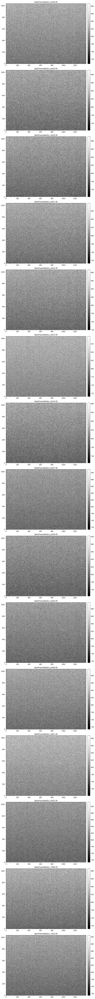

In [5]:
dark_red_1s_stack.plot_all()

<AxesSubplot:>

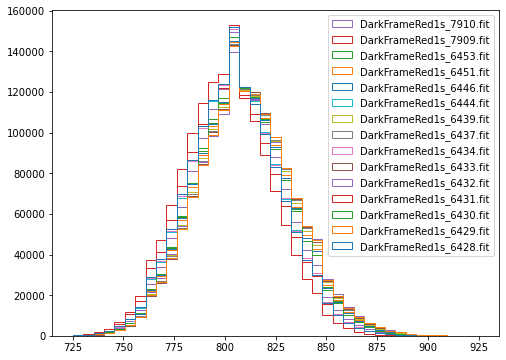

In [6]:
dark_red_1s_stack.plot_all_hist(histmin=725,histmax=925)

/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:36: RuntimeWarning: Mean of empty slice


Text(0.5, 1.0, 'Master Bias + 1s Dark Current Image for Red Detector')

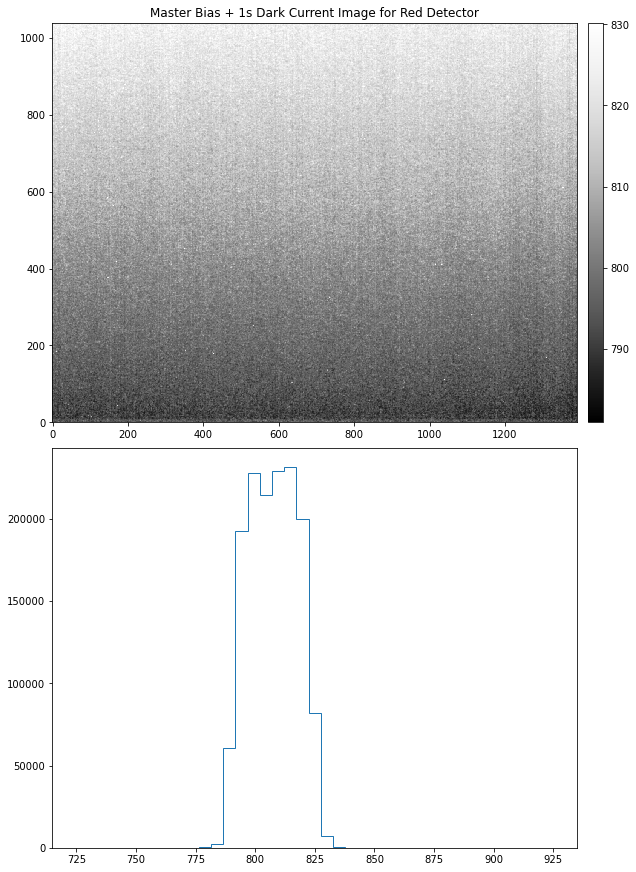

In [7]:
dark_red_1s_stack.calculate_bias(mask_sigma=5,kernel_std=1)
ax1, _ = dark_red_1s_stack.plot_bias_smooth(hist_min=725,hist_max=925)
ax1.set_title("Master Bias + 1s Dark Current Image for Red Detector")

In [8]:
bias_dc_red_1s = dark_red_1s_stack.bias_smooth
with h5py.File("../../sav/Eclipse/Bias/master_bias_dc_red_1s_proto.h5", 'w') as hf:
    hf.create_dataset("image",  data=bias_dc_red_1s)

In [9]:
fname_dark_red_3s = ["DarkFrameRed3s_6313.fit","DarkFrameRed3s_6314.fit","DarkFrameRed3s_6315.fit","DarkFrameRed3s_6316.fit",
                    "DarkFrameRed3s_6317.fit","DarkFrameRed3s_6319.fit","DarkFrameRed3s_6320.fit","DarkFrameRed3s_6321.fit",
                    "DarkFrameRed3s_6322.fit","DarkFrameRed3s_6324.fit","DarkFrameRed3s_6326.fit","DarkFrameRed3s_6328.fit",
                    "DarkFrameRed3s_6331.fit","DarkFrameRed3s_6333.fit","DarkFrameRed3s_6335.fit"]

In [10]:
dark_red_3s_stack = DarkFrameStack(fname_dark_red_3s,red_path)

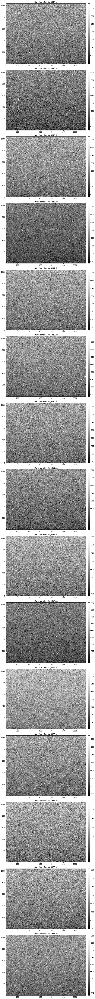

In [11]:
dark_red_3s_stack.plot_all()

<AxesSubplot:>

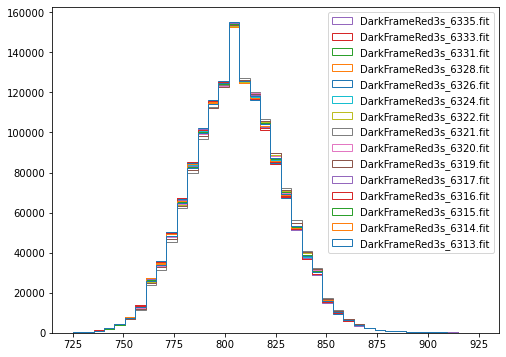

In [12]:
dark_red_3s_stack.plot_all_hist(histmin=725,histmax=925)

/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:36: RuntimeWarning: Mean of empty slice


Text(0.5, 1.0, 'Master Bias + 3s Dark Current Image for Red Detector')

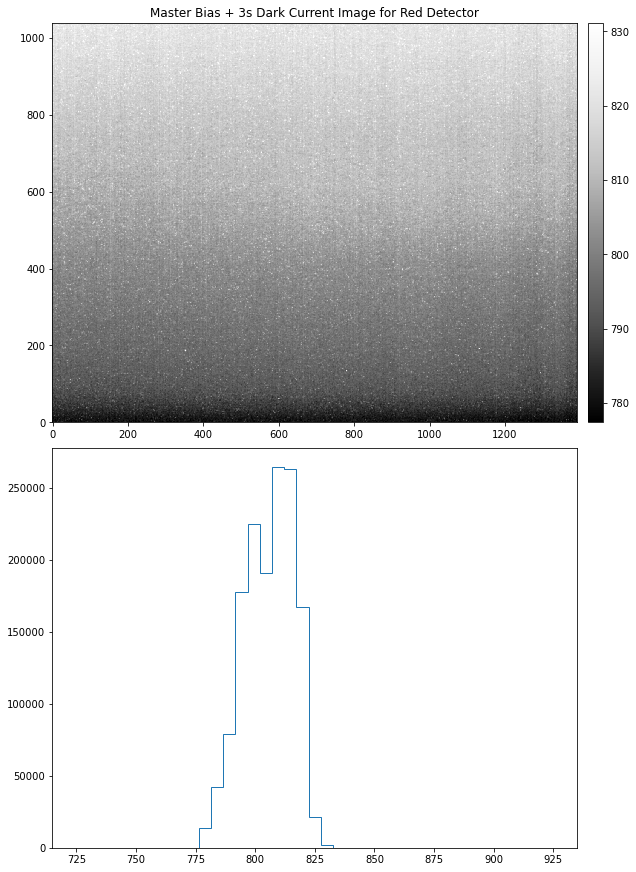

In [13]:
dark_red_3s_stack.calculate_bias(mask_sigma=5,kernel_std=1)
ax1, _ = dark_red_3s_stack.plot_bias_smooth(hist_min=725,hist_max=925)
ax1.set_title("Master Bias + 3s Dark Current Image for Red Detector")

In [14]:
bias_dc_red_3s = dark_red_3s_stack.bias_smooth
with h5py.File("../../sav/Eclipse/Bias/master_bias_dc_red_3s_proto.h5", 'w') as hf:
    hf.create_dataset("image",  data=bias_dc_red_3s)

In [15]:
fname_dark_red_5s = ["DarkFrameRed5s_6291.fit","DarkFrameRed5s_6294.fit","DarkFrameRed5s_6296.fit","DarkFrameRed5s_6298.fit",
                    "DarkFrameRed5s_6301.fit","DarkFrameRed5s_6302.fit","DarkFrameRed5s_6303.fit","DarkFrameRed5s_6305.fit",
                    "DarkFrameRed5s_6306.fit","DarkFrameRed5s_6308.fit","DarkFrameRed5s_6309.fit","DarkFrameRed5s_6310.fit"]

In [16]:
dark_red_5s_stack = DarkFrameStack(fname_dark_red_5s,red_path)

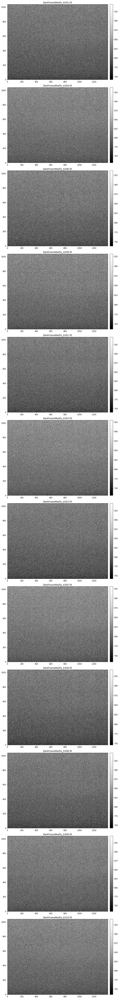

In [17]:
dark_red_5s_stack.plot_all()

<AxesSubplot:>

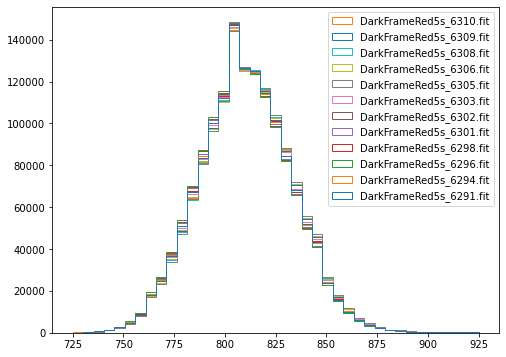

In [18]:
dark_red_5s_stack.plot_all_hist(histmin=725,histmax=925)

/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:36: RuntimeWarning: Mean of empty slice


Text(0.5, 1.0, 'Master Bias + 5s Dark Current Image for Red Detector')

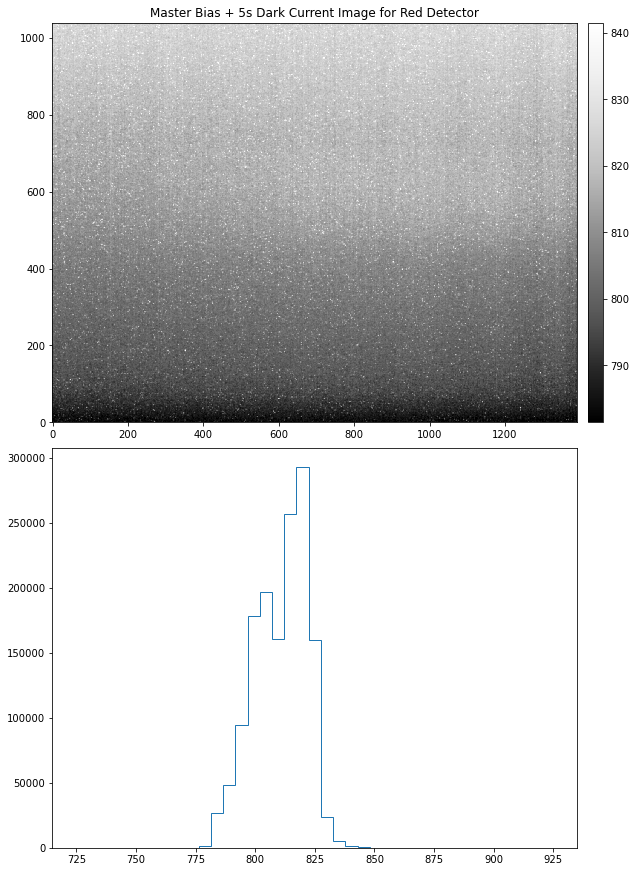

In [19]:
dark_red_5s_stack.calculate_bias(mask_sigma=5,kernel_std=1)
ax1, _ = dark_red_5s_stack.plot_bias_smooth(hist_min=725,hist_max=925)
ax1.set_title("Master Bias + 5s Dark Current Image for Red Detector")

In [20]:
bias_dc_red_5s = dark_red_5s_stack.bias_smooth
with h5py.File("../../sav/Eclipse/Bias/master_bias_dc_red_5s_proto.h5", 'w') as hf:
    hf.create_dataset("image",  data=bias_dc_red_5s)